
***

## Lyft/Uber Price Prediction  

Given *data about Lyft and Uber rides*, let's try to predict the **price** of a given ride.  
  
We will use a linear regression model to make our predictions.

# Getting Started

In [5]:
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn.linear_model import LinearRegression

In [6]:
import os, types
import pandas as pd
from botocore.client import Config
import ibm_boto3

def __iter__(self): return 0

# @hidden_cell
# The following code accesses a file in your IBM Cloud Object Storage. It includes your credentials.
# You might want to remove those credentials before you share the notebook.

if os.environ.get('RUNTIME_ENV_LOCATION_TYPE') == 'external':
    endpoint_f8ec321073d24c11ab86d245d4fbe6a7 = 'https://s3.us.cloud-object-storage.appdomain.cloud'
else:
    endpoint_f8ec321073d24c11ab86d245d4fbe6a7 = 'https://s3.private.us.cloud-object-storage.appdomain.cloud'

client_f8ec321073d24c11ab86d245d4fbe6a7 = ibm_boto3.client(service_name='s3',
    ibm_api_key_id='SzRH3O9PkkDPguNkewibchy-vIA9KBhqRrMSVYlk5pI2',
    ibm_auth_endpoint="https://iam.cloud.ibm.com/oidc/token",
    config=Config(signature_version='oauth'),
    endpoint_url=endpoint_f8ec321073d24c11ab86d245d4fbe6a7)

body = client_f8ec321073d24c11ab86d245d4fbe6a7.get_object(Bucket='cabpriceprediction-donotdelete-pr-r1w8meq6l2bunz',Key='cab_rides.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

rides_df = pd.read_csv(body)
rides_df.head()

,distance,cab_type,time_stamp,destination,source,price,surge_multiplier,id,product_id,name
0,0.44,Lyft,1544952607890,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared
1,0.44,Lyft,1543284023677,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux
2,0.44,Lyft,1543366822198,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft
3,0.44,Lyft,1543553582749,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL
4,0.44,Lyft,1543463360223,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL


In [7]:

body = client_f8ec321073d24c11ab86d245d4fbe6a7.get_object(Bucket='cabpriceprediction-donotdelete-pr-r1w8meq6l2bunz',Key='weather.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

weather_df = pd.read_csv(body)
weather_df.head()


,temp,location,clouds,pressure,rain,time_stamp,humidity,wind
0,42.42,Back Bay,1.0,1012.14,0.1228,1545003901,0.77,11.25
1,42.43,Beacon Hill,1.0,1012.15,0.1846,1545003901,0.76,11.32
2,42.50,Boston University,1.0,1012.15,0.1089,1545003901,0.76,11.07
3,42.11,Fenway,1.0,1012.13,0.0969,1545003901,0.77,11.09
4,43.13,Financial District,1.0,1012.14,0.1786,1545003901,0.75,11.49


In [8]:
rides_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693071 entries, 0 to 693070
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   distance          693071 non-null  float64
 1   cab_type          693071 non-null  object 
 2   time_stamp        693071 non-null  int64  
 3   destination       693071 non-null  object 
 4   source            693071 non-null  object 
 5   price             637976 non-null  float64
 6   surge_multiplier  693071 non-null  float64
 7   id                693071 non-null  object 
 8   product_id        693071 non-null  object 
 9   name              693071 non-null  object 
dtypes: float64(3), int64(1), object(6)
memory usage: 52.9+ MB


In [9]:
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6276 entries, 0 to 6275
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   temp        6276 non-null   float64
 1   location    6276 non-null   object 
 2   clouds      6276 non-null   float64
 3   pressure    6276 non-null   float64
 4   rain        894 non-null    float64
 5   time_stamp  6276 non-null   int64  
 6   humidity    6276 non-null   float64
 7   wind        6276 non-null   float64
dtypes: float64(6), int64(1), object(1)
memory usage: 392.4+ KB


# Cleaning Ride Data

In [10]:
rides_df

,distance,cab_type,time_stamp,destination,source,price,surge_multiplier,id,product_id,name
0,0.44,Lyft,1544952607890,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared
1,0.44,Lyft,1543284023677,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux
2,0.44,Lyft,1543366822198,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft
3,0.44,Lyft,1543553582749,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL
4,0.44,Lyft,1543463360223,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL
...,...,...,...,...,...,...,...,...,...,...
693066,1.00,Uber,1543708385534,North End,West End,13.0,1.0,616d3611-1820-450a-9845-a9ff304a4842,6f72dfc5-27f1-42e8-84db-ccc7a75f6969,UberXL
693067,1.00,Uber,1543708385534,North End,West End,9.5,1.0,633a3fc3-1f86-4b9e-9d48-2b7132112341,55c66225-fbe7-4fd5-9072-eab1ece5e23e,UberX
693068,1.00,Uber,1543708385534,North End,West End,NaN,1.0,64d451d0-639f-47a4-9b7c-6fd92fbd264f,8cf7e821-f0d3-49c6-8eba-e679c0ebcf6a,Taxi
693069,1.00,Uber,1543708385534,North End,West End,27.0,1.0,727e5f07-a96b-4ad1-a2c7-9abc3ad55b4e,6d318bcc-22a3-4af6-bddd-b409bfce1546,Black SUV


In [11]:
rides_df.isna().sum()

distance                0
cab_type                0
time_stamp              0
destination             0
source                  0
price               55095
surge_multiplier        0
id                      0
product_id              0
name                    0
dtype: int64

In [12]:
rides_df = rides_df.dropna(axis=0).reset_index(drop=True)

# Cleaning Weather Data

In [13]:
weather_df

,temp,location,clouds,pressure,rain,time_stamp,humidity,wind
0,42.42,Back Bay,1.00,1012.14,0.1228,1545003901,0.77,11.25
1,42.43,Beacon Hill,1.00,1012.15,0.1846,1545003901,0.76,11.32
2,42.50,Boston University,1.00,1012.15,0.1089,1545003901,0.76,11.07
3,42.11,Fenway,1.00,1012.13,0.0969,1545003901,0.77,11.09
4,43.13,Financial District,1.00,1012.14,0.1786,1545003901,0.75,11.49
...,...,...,...,...,...,...,...,...
6271,44.72,North Station,0.89,1000.69,NaN,1543819974,0.96,1.52
6272,44.85,Northeastern University,0.88,1000.71,NaN,1543819974,0.96,1.54
6273,44.82,South Station,0.89,1000.70,NaN,1543819974,0.96,1.54
6274,44.78,Theatre District,0.89,1000.70,NaN,1543819974,0.96,1.54


In [14]:
weather_df.isna().sum()

temp             0
location         0
clouds           0
pressure         0
rain          5382
time_stamp       0
humidity         0
wind             0
dtype: int64

In [15]:
weather_df = weather_df.fillna(0)

# Creating Average Weather DataFrame

In [16]:
weather_df

,temp,location,clouds,pressure,rain,time_stamp,humidity,wind
0,42.42,Back Bay,1.00,1012.14,0.1228,1545003901,0.77,11.25
1,42.43,Beacon Hill,1.00,1012.15,0.1846,1545003901,0.76,11.32
2,42.50,Boston University,1.00,1012.15,0.1089,1545003901,0.76,11.07
3,42.11,Fenway,1.00,1012.13,0.0969,1545003901,0.77,11.09
4,43.13,Financial District,1.00,1012.14,0.1786,1545003901,0.75,11.49
...,...,...,...,...,...,...,...,...
6271,44.72,North Station,0.89,1000.69,0.0000,1543819974,0.96,1.52
6272,44.85,Northeastern University,0.88,1000.71,0.0000,1543819974,0.96,1.54
6273,44.82,South Station,0.89,1000.70,0.0000,1543819974,0.96,1.54
6274,44.78,Theatre District,0.89,1000.70,0.0000,1543819974,0.96,1.54


In [17]:
# converting the timestamp data into real date format
rides_df['date'] = pd.to_datetime(rides_df['time_stamp']/ 1000, unit = 's')
weather_df['date'] = pd.to_datetime(weather_df['time_stamp'], unit = 's')

In [18]:
# Creating the new column that contain the location and 
rides_df['merged_date'] = rides_df['source'].astype('str') + ' - ' + rides_df['date'].dt.strftime('%Y-%m-%d').astype('str') + ' - ' + rides_df['date'].dt.hour.astype('str')
weather_df['merged_date'] = weather_df['location'].astype('str') + ' - ' + weather_df['date'].dt.strftime('%Y-%m-%d').astype('str') + ' - ' + weather_df['date'].dt.hour.astype('str')

In [19]:
#  df_rides['date'].dt.strftime('%m').head()
weather_df.index = weather_df['merged_date']

In [20]:
# Join the weather date on rides data
df_joined = rides_df.join(weather_df, on = ['merged_date'], rsuffix ='_w')

The rides and weather data have been joined by merged_date column.

In [21]:
df_joined.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1167730 entries, 0 to 637975
Data columns (total 22 columns):
 #   Column            Non-Null Count    Dtype         
---  ------            --------------    -----         
 0   distance          1167730 non-null  float64       
 1   cab_type          1167730 non-null  object        
 2   time_stamp        1167730 non-null  int64         
 3   destination       1167730 non-null  object        
 4   source            1167730 non-null  object        
 5   price             1167730 non-null  float64       
 6   surge_multiplier  1167730 non-null  float64       
 7   id                1167730 non-null  object        
 8   product_id        1167730 non-null  object        
 9   name              1167730 non-null  object        
 10  date              1167730 non-null  datetime64[ns]
 11  merged_date       1167730 non-null  object        
 12  temp              1164996 non-null  float64       
 13  location          1164996 non-null  object 

In [22]:
df_joined['id'].value_counts()

711961d5-9a30-47f5-b0e7-b6062e731951    15
f23598c2-bc5d-44cc-96d2-4d540f21cf7e    15
67a0ffab-9f7b-42c9-a2e1-687d80d6406e    15
84057e80-bbd0-479d-9545-4b9b004b9850    15
afd14287-e834-456d-b9fb-8fc2a11e3861    15
                                        ..
d50ea03d-c4b9-4766-97e5-71e74686ddcb     1
2b82ac5f-77f8-445c-9d39-532883a33f0c     1
507f1476-595e-4e09-b6d9-65aa235af8e4     1
647bf3a3-fa09-41fb-ad21-3203596ab8f9     1
10268b52-5e47-43c5-b50b-53ae9710dc0c     1
Name: id, Length: 637976, dtype: int64

In [23]:
df_joined[df_joined['id'] == '865b44b9-4235-4e8e-b6fd-bc8373e95b63'].iloc[:,10:22]

,date,merged_date,temp,location,clouds,pressure,rain,time_stamp_w,humidity,wind,date_w,merged_date_w
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,40.51,Financial District,1.00,1014.18,0.0,1.543213e+09,0.92,1.28,2018-11-26 06:16:45,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,41.61,Financial District,0.98,1014.35,0.0,1.543215e+09,0.91,1.82,2018-11-26 06:49:02,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,40.50,Financial District,1.00,1014.18,0.0,1.543213e+09,0.92,1.27,2018-11-26 06:15:45,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,40.49,Financial District,1.00,1014.18,0.0,1.543213e+09,0.91,1.22,2018-11-26 06:12:14,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,43.95,Financial District,1.00,1014.18,0.0,1.543213e+09,0.80,1.38,2018-11-26 06:24:04,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,43.97,Financial District,1.00,1014.18,0.0,1.543214e+09,0.81,1.45,2018-11-26 06:29:03,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,41.65,Financial District,0.98,1014.31,0.0,1.543215e+09,0.90,1.76,2018-11-26 06:50:30,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,40.50,Financial District,1.00,1014.18,0.0,1.543213e+09,0.92,1.25,2018-11-26 06:14:16,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,41.61,Financial District,0.98,1014.35,0.0,1.543215e+09,0.91,1.83,2018-11-26 06:49:43,Financial District - 2018-11-26 - 6
560855,2018-11-26 06:28:02.305999872,Financial District - 2018-11-26 - 6,40.51,Financial District,1.00,1014.18,0.0,1.543213e+09,0.92,1.28,2018-11-26 06:16:15,Financial District - 2018-11-26 - 6


In [24]:
id_group = pd.DataFrame(df_joined.groupby('id')['temp','clouds', 'pressure', 'rain', 'humidity', 'wind'].mean())
df_rides_weather = rides_df.join(id_group, on = ['id'])

/tmp/wsuser/ipykernel_154/1606526773.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  id_group = pd.DataFrame(df_joined.groupby('id')['temp','clouds', 'pressure', 'rain', 'humidity', 'wind'].mean())


In [25]:
# Creating the columns for Month, Hour and Weekdays 
df_rides_weather['Month'] = df_rides_weather['date'].dt.month
df_rides_weather['Hour'] = df_rides_weather['date'].dt.hour
df_rides_weather['Day'] =  df_rides_weather['date'].dt.strftime('%A')

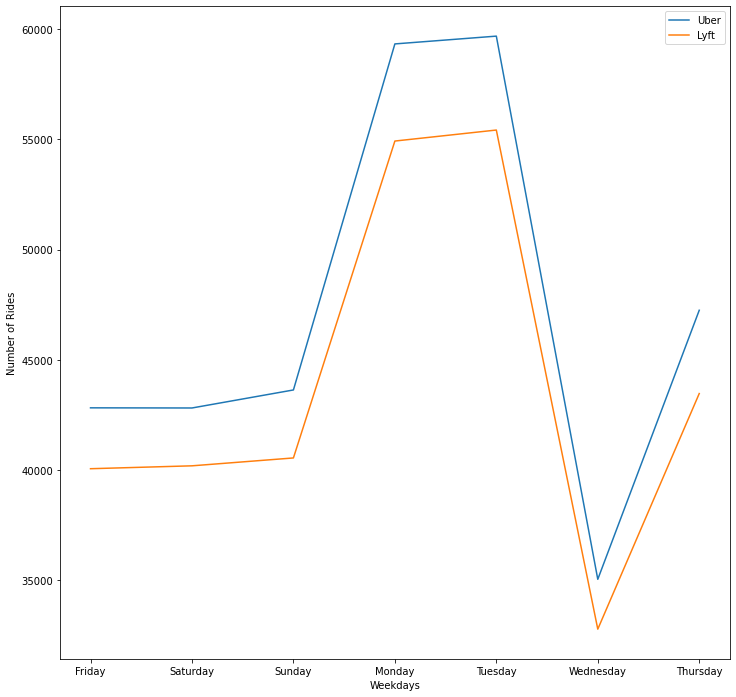

In [26]:
# The distribution of rides in weekdays 
import matplotlib.pyplot as plt
uber_day_count = df_rides_weather[df_rides_weather['cab_type'] == 'Uber']['Day'].value_counts()
uber_day_count = uber_day_count.reindex(index = ['Friday','Saturday','Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday'])
lyft_day_count = df_rides_weather[df_rides_weather['cab_type'] == 'Lyft']['Day'].value_counts()
lyft_day_count = lyft_day_count.reindex(index = ['Friday','Saturday','Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday'])

fig , ax = plt.subplots(figsize = (12,12))
ax.plot(uber_day_count.index, uber_day_count, label = 'Uber')
ax.plot(lyft_day_count.index, lyft_day_count, label = 'Lyft')
ax.set(ylabel = 'Number of Rides', xlabel = 'Weekdays')
ax.legend()
plt.show()

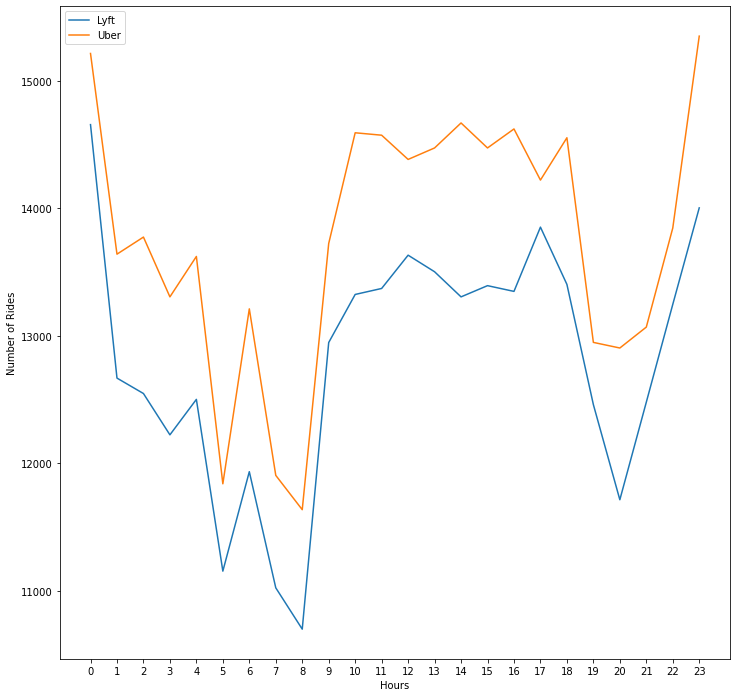

In [27]:
# The ride distribution in one day 
fig , ax = plt.subplots(figsize= (12,12))
ax.plot(df_rides_weather[df_rides_weather['cab_type'] == 'Lyft'].groupby('Hour').Hour.count().index, df_rides_weather[df_rides_weather['cab_type'] == 'Lyft'].groupby('Hour').Hour.count(), label = 'Lyft')
ax.plot(df_rides_weather[df_rides_weather['cab_type'] == 'Uber'].groupby('Hour').Hour.count().index, df_rides_weather[df_rides_weather['cab_type'] =='Uber'].groupby('Hour').Hour.count(), label = 'Uber')
ax.legend()
ax.set(xlabel = 'Hours', ylabel = 'Number of Rides')
plt.xticks(range(0,24,1))
plt.show()


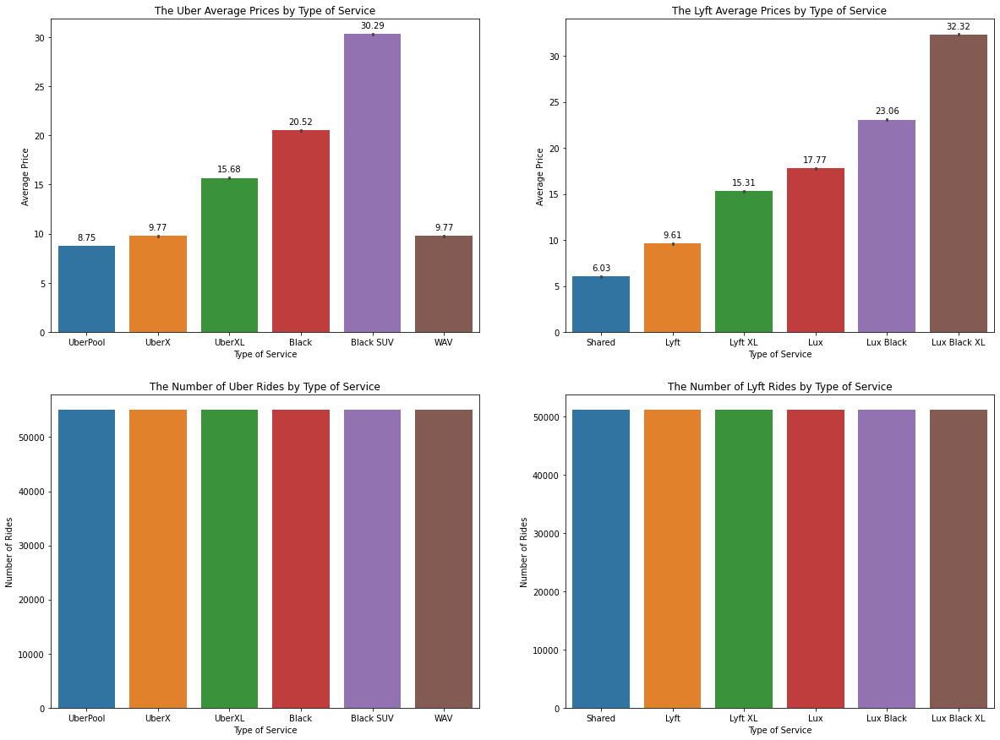

In [28]:
# The Average price of rides by type of service
import seaborn as sns

uber_order =[ 'UberPool', 'UberX', 'UberXL', 'Black','Black SUV','WAV' ]
lyft_order = ['Shared', 'Lyft', 'Lyft XL', 'Lux', 'Lux Black', 'Lux Black XL']
fig, ax = plt.subplots(2,2, figsize = (20,15))
ax1 = sns.barplot(x = df_rides_weather[df_rides_weather['cab_type'] == 'Uber'].name, y = df_rides_weather[df_rides_weather['cab_type'] == 'Uber'].price , ax = ax[0,0], order = uber_order)
ax2 = sns.barplot(x = df_rides_weather[df_rides_weather['cab_type'] == 'Lyft'].name, y = df_rides_weather[df_rides_weather['cab_type'] == 'Lyft'].price , ax = ax[0,1], order = lyft_order)
ax3 = sns.barplot(x = df_rides_weather[df_rides_weather['cab_type'] == 'Uber'].groupby('name').name.count().index, y = df_rides_weather[df_rides_weather['cab_type'] == 'Uber'].groupby('name').name.count(), ax = ax[1,0] ,order = uber_order)
ax4 = sns.barplot(x = df_rides_weather[df_rides_weather['cab_type'] == 'Lyft'].groupby('name').name.count().index, y = df_rides_weather[df_rides_weather['cab_type'] == 'Lyft'].groupby('name').name.count(), ax = ax[1,1],order = lyft_order)
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
for p in ax2.patches:
    ax2.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
ax1.set(xlabel = 'Type of Service', ylabel = 'Average Price')
ax2.set(xlabel = 'Type of Service', ylabel = 'Average Price')
ax3.set(xlabel = 'Type of Service', ylabel = 'Number of Rides')
ax4.set(xlabel = 'Type of Service', ylabel = 'Number of Rides')
ax1.set_title('The Uber Average Prices by Type of Service')
ax2.set_title('The Lyft Average Prices by Type of Service')
ax3.set_title('The Number of Uber Rides by Type of Service')
ax4.set_title('The Number of Lyft Rides by Type of Service')
plt.show()

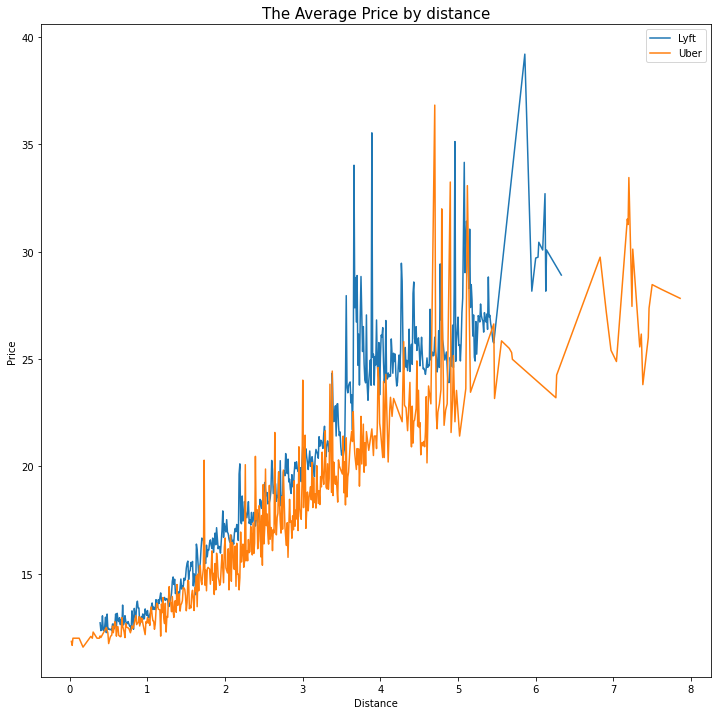

In [29]:
# The average price by distance
fig , ax = plt.subplots(figsize = (12,12))
ax.plot(df_rides_weather[df_rides_weather['cab_type'] == 'Lyft'].groupby('distance').price.mean().index, df_rides_weather[df_rides_weather['cab_type'] == 'Lyft'].groupby('distance')['price'].mean(), label = 'Lyft')
ax.plot(df_rides_weather[df_rides_weather['cab_type'] == 'Uber'].groupby('distance').price.mean().index, df_rides_weather[df_rides_weather['cab_type'] =='Uber'].groupby('distance').price.mean(), label = 'Uber')
ax.set_title('The Average Price by distance', fontsize= 15)
ax.set(xlabel = 'Distance', ylabel = 'Price' )
ax.legend()
plt.show()


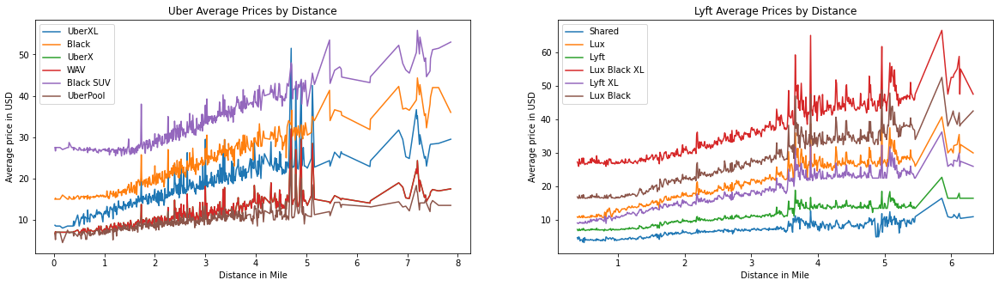

In [30]:
# The average price by distance 
fig, ax = plt.subplots(1,2 , figsize = (20,5))
for i,col in enumerate(df_rides_weather[df_rides_weather['cab_type'] == 'Uber']['name'].unique()):
    ax[0].plot(df_rides_weather[ df_rides_weather['name'] == col].groupby('distance').price.mean().index, df_rides_weather[ df_rides_weather['name'] == col].groupby('distance').price.mean(), label = col)
ax[0].set_title('Uber Average Prices by Distance')
ax[0].set(xlabel = 'Distance in Mile', ylabel = 'Average price in USD')
ax[0].legend()
for i,col in enumerate(df_rides_weather[df_rides_weather['cab_type'] == 'Lyft']['name'].unique()):
    ax[1].plot(df_rides_weather[ df_rides_weather['name'] == col].groupby('distance').price.mean().index, df_rides_weather[ df_rides_weather['name'] == col].groupby('distance').price.mean(), label = col)
ax[1].set(xlabel = 'Distance in Mile', ylabel = 'Average price in USD')
ax[1].set_title('Lyft Average Prices by Distance')
ax[1].legend()
plt.show()


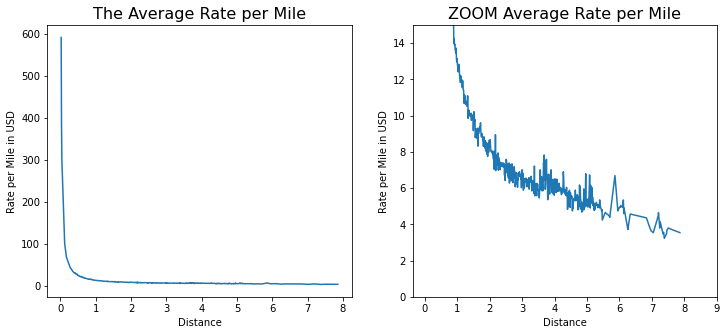

In [31]:
# the average rate per mile
df_rides_weather['rate_per_mile'] = round((df_rides_weather['price'] / df_rides_weather['distance'] ),2)
# The average rate per mile plot
fig, ax = plt.subplots(1,2,figsize = (12,5))
ax1 = sns.lineplot(x = df_rides_weather.groupby(['distance'])['rate_per_mile'].mean().index, y = df_rides_weather.groupby('distance')['rate_per_mile'].mean(), ax = ax[0])
ax2 = sns.lineplot(x = df_rides_weather.groupby(['distance'])['rate_per_mile'].mean().index, y = df_rides_weather.groupby('distance')['rate_per_mile'].mean(), ax = ax[1])
plt.xticks(range(0, 10,1))
ax1.set(xlabel = 'Distance', ylabel = 'Rate per Mile in USD')
ax2.set(xlabel = 'Distance', ylabel = 'Rate per Mile in USD', ylim = (0,15))
ax1.set_title('The Average Rate per Mile', fontsize = 16)
ax2.set_title('ZOOM Average Rate per Mile', fontsize = 16)
plt.show()

In [32]:
# Scatter chart for Rate per mile and distance
    # pivot table to calculate average rate based on cab_type, service type(name) and distance
rates_per_mile_pivot = df_rides_weather.pivot_table(index = ['cab_type', 'name', 'distance'] , values = ['rate_per_mile'])
rates_per_mile_pivot.reset_index(inplace = True)

IndexError: list index out of range

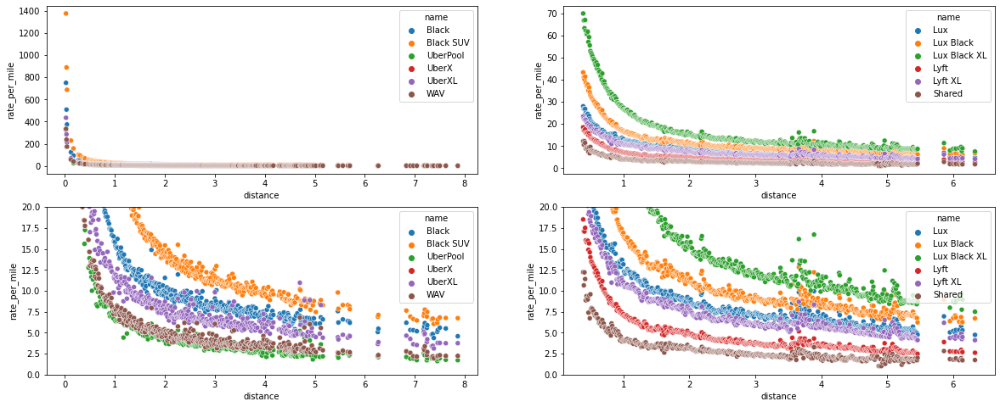

In [33]:
fig, ax = plt.subplots(2,2, figsize = (20,8))
ax1 = sns.scatterplot(x = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Uber']['distance'], y = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Uber']['rate_per_mile'], hue = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Uber']['name'], ax = ax[0,0])
ax2 = sns.scatterplot(x = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Uber']['distance'], y = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Uber']['rate_per_mile'], hue = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Uber']['name'], ax = ax[1,0])
ax2.set( ylim = (0,20))
ax3 = sns.scatterplot(x = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Lyft']['distance'], y = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Lyft']['rate_per_mile'], hue = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Lyft']['name'], ax = ax[0,1])
ax4 = sns.scatterplot(x = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Lyft']['distance'], y = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Lyft']['rate_per_mile'], hue = rates_per_mile_pivot[rates_per_mile_pivot['cab_type'] == 'Lyft']['name'], ax = ax[1,1])
ax4.set( ylim = (0,20))
handles_uber, labels_uber = ax1.get_legend_handles_labels()
handles_uber = [handles_uber[6],handles_uber[3],handles_uber[4],handles_uber[5],handles_uber[1],handles_uber[2]]
labels_uber = [labels_uber[6],labels_uber[3],labels_uber[4],labels_uber[5],labels_uber[1],labels_uber[2]]
ax1.legend(handles_uber, labels_uber)
ax2.legend(handles_uber, labels_uber)
handles_lyft, labels_lyft = ax3.get_legend_handles_labels()
handles_lyft = [handles_lyft[6],handles_lyft[4],handles_lyft[5],handles_lyft[1],handles_lyft[2],handles_lyft[3]]
labels_lyft = [labels_lyft[6],labels_lyft[4],labels_lyft[5],labels_lyft[1],labels_lyft[2],labels_lyft[3]]
ax3.legend(handles_lyft, labels_lyft)
ax4.legend(handles_lyft, labels_lyft)
ax1.set_title('Uber Rate per Mile')
ax1.set(ylabel = 'Rate per Mile in USD', xlabel = ' ')
ax2.set_title('Uber Rate Zoom(0 to 20 USD)')
ax2.set(ylabel = 'Rate per Mile in USD', xlabel = 'Distance')
ax3.set_title('Lyft Rate per Mile')
ax3.set(ylabel = ' ', xlabel = ' ')
ax4.set_title('Lyft Rate Zoom(0 to 20 USD)')
ax4.set(ylabel = ' ', xlabel = 'Distance')
plt.show()

In [34]:
# Overrated rides
high_mile_rates = df_rides_weather[df_rides_weather['rate_per_mile'] > 80]
# The number of overrated rides by cab type
high_mile_rates['cab_type'].value_counts()

Uber    414
Lyft     39
Name: cab_type, dtype: int64

In [35]:
# Overrated Lyft rides
high_mile_rates[high_mile_rates['cab_type'] == 'Lyft'].loc[:,['distance', 'cab_type', 'price', 'surge_multiplier','name', 'rate_per_mile']]


,distance,cab_type,price,surge_multiplier,name,rate_per_mile
1224,0.46,Lyft,45.5,1.75,Lux Black XL,98.91
35902,0.46,Lyft,38.5,1.50,Lux Black XL,83.70
61335,0.59,Lyft,52.5,2.00,Lux Black XL,88.98
74265,0.58,Lyft,55.0,2.00,Lux Black XL,94.83
87334,0.45,Lyft,38.5,1.50,Lux Black XL,85.56
96835,0.46,Lyft,38.0,1.50,Lux Black XL,82.61
101159,0.46,Lyft,38.0,1.50,Lux Black XL,82.61
110322,0.59,Lyft,47.5,1.75,Lux Black XL,80.51
127056,0.46,Lyft,52.5,2.00,Lux Black XL,114.13
148169,0.46,Lyft,52.5,2.00,Lux Black XL,114.13


In [36]:
# Overrated Uber Rides
high_mile_rates[high_mile_rates['cab_type'] == 'Uber'].loc[:,['distance', 'cab_type', 'price', 'surge_multiplier','name', 'rate_per_mile']].sort_values(by = 'rate_per_mile', ascending = False).head(20)

,distance,cab_type,price,surge_multiplier,name,rate_per_mile
159255,0.02,Uber,27.5,1.0,Black SUV,1375.00
532216,0.02,Uber,27.5,1.0,Black SUV,1375.00
382391,0.02,Uber,27.5,1.0,Black SUV,1375.00
205299,0.02,Uber,27.5,1.0,Black SUV,1375.00
209404,0.02,Uber,27.5,1.0,Black SUV,1375.00
396748,0.02,Uber,27.5,1.0,Black SUV,1375.00
405661,0.02,Uber,27.5,1.0,Black SUV,1375.00
473886,0.02,Uber,27.5,1.0,Black SUV,1375.00
550645,0.02,Uber,27.5,1.0,Black SUV,1375.00
10398,0.02,Uber,27.5,1.0,Black SUV,1375.00


In [37]:
# The number of rides based on service type, distance, and price 
over_rated_pivot = high_mile_rates[high_mile_rates['cab_type'] == 'Uber'].pivot_table(index = ['name', 'distance', 'price'], values = ['id'], aggfunc = len).rename(columns = {'id' : 'count_rides'})
over_rated_pivot.reset_index(inplace =True)
over_rated_pivot.sort_values(by = ['count_rides', 'name'], ascending = False).head(15)

,name,distance,price,count_rides
54,WAV,0.03,7.0,32
43,UberX,0.03,7.0,32
49,UberXL,0.03,8.5,23
36,UberPool,0.03,4.5,17
12,Black SUV,0.03,27.5,17
56,WAV,0.04,7.0,14
51,UberXL,0.04,8.5,14
45,UberX,0.04,7.0,14
40,UberPool,0.04,7.0,14
13,Black SUV,0.04,27.5,14


All of the ride distances are very short and the number of rides of one specific service type are very high. So, these are cancellations and their prices.

**Cancellation prices by service type**
* WAV: 7.0
* UberPool: 4.5
* UberX: 7.0
* UberXL: 8.5
* Black: 15.0
* Black SUV: 27.5

Based on these prices, if you are not ready to go, don't call Black SUV :D

In [38]:
#before cells are testing

weather_df.groupby('location').mean()

,temp,clouds,pressure,rain,time_stamp,humidity,wind
location,,,,,,,
Back Bay,39.082122,0.678432,1008.447820,0.007925,1.543857e+09,0.764073,6.778528
Beacon Hill,39.047285,0.677801,1008.448356,0.008297,1.543857e+09,0.765048,6.810325
Boston University,39.047744,0.679235,1008.459254,0.007738,1.543857e+09,0.763786,6.692180
Fenway,38.964379,0.679866,1008.453289,0.007343,1.543857e+09,0.767266,6.711721
Financial District,39.410822,0.676730,1008.435793,0.008563,1.543857e+09,0.754837,6.860019
Haymarket Square,39.067897,0.676711,1008.445239,0.008660,1.543857e+09,0.764837,6.843193
North End,39.090841,0.676730,1008.441912,0.008644,1.543857e+09,0.764054,6.853117
North Station,39.035315,0.676998,1008.442811,0.008649,1.543857e+09,0.765545,6.835755
Northeastern University,38.975086,0.678317,1008.444168,0.007358,1.543857e+09,0.767648,6.749426


In [39]:
avg_weather_df = weather_df.groupby('location').mean().reset_index(drop=False)
avg_weather_df = avg_weather_df.drop('time_stamp', axis=1)
avg_weather_df

,location,temp,clouds,pressure,rain,humidity,wind
0,Back Bay,39.082122,0.678432,1008.447820,0.007925,0.764073,6.778528
1,Beacon Hill,39.047285,0.677801,1008.448356,0.008297,0.765048,6.810325
2,Boston University,39.047744,0.679235,1008.459254,0.007738,0.763786,6.692180
3,Fenway,38.964379,0.679866,1008.453289,0.007343,0.767266,6.711721
4,Financial District,39.410822,0.676730,1008.435793,0.008563,0.754837,6.860019
5,Haymarket Square,39.067897,0.676711,1008.445239,0.008660,0.764837,6.843193
6,North End,39.090841,0.676730,1008.441912,0.008644,0.764054,6.853117
7,North Station,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
8,Northeastern University,38.975086,0.678317,1008.444168,0.007358,0.767648,6.749426
9,South Station,39.394092,0.677495,1008.438031,0.008310,0.755468,6.848948


# Merging DataFrames

In [40]:
rides_df = rides_df.drop('merged_date', axis=1)
rides_df = rides_df.drop('date', axis=1)
rides_df


,distance,cab_type,time_stamp,destination,source,price,surge_multiplier,id,product_id,name
0,0.44,Lyft,1544952607890,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared
1,0.44,Lyft,1543284023677,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux
2,0.44,Lyft,1543366822198,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft
3,0.44,Lyft,1543553582749,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL
4,0.44,Lyft,1543463360223,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL
...,...,...,...,...,...,...,...,...,...,...
637971,1.00,Uber,1543708385534,North End,West End,9.5,1.0,353e6566-b272-479e-a9c6-98bd6cb23f25,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV
637972,1.00,Uber,1543708385534,North End,West End,13.0,1.0,616d3611-1820-450a-9845-a9ff304a4842,6f72dfc5-27f1-42e8-84db-ccc7a75f6969,UberXL
637973,1.00,Uber,1543708385534,North End,West End,9.5,1.0,633a3fc3-1f86-4b9e-9d48-2b7132112341,55c66225-fbe7-4fd5-9072-eab1ece5e23e,UberX
637974,1.00,Uber,1543708385534,North End,West End,27.0,1.0,727e5f07-a96b-4ad1-a2c7-9abc3ad55b4e,6d318bcc-22a3-4af6-bddd-b409bfce1546,Black SUV


In [41]:
weather_df = weather_df.drop('merged_date', axis=1)
weather_df = weather_df.drop('date', axis=1)
weather_df

,temp,location,clouds,pressure,rain,time_stamp,humidity,wind
merged_date,,,,,,,,
Back Bay - 2018-12-16 - 23,42.42,Back Bay,1.00,1012.14,0.1228,1545003901,0.77,11.25
Beacon Hill - 2018-12-16 - 23,42.43,Beacon Hill,1.00,1012.15,0.1846,1545003901,0.76,11.32
Boston University - 2018-12-16 - 23,42.50,Boston University,1.00,1012.15,0.1089,1545003901,0.76,11.07
Fenway - 2018-12-16 - 23,42.11,Fenway,1.00,1012.13,0.0969,1545003901,0.77,11.09
Financial District - 2018-12-16 - 23,43.13,Financial District,1.00,1012.14,0.1786,1545003901,0.75,11.49
...,...,...,...,...,...,...,...,...
North Station - 2018-12-03 - 6,44.72,North Station,0.89,1000.69,0.0000,1543819974,0.96,1.52
Northeastern University - 2018-12-03 - 6,44.85,Northeastern University,0.88,1000.71,0.0000,1543819974,0.96,1.54
South Station - 2018-12-03 - 6,44.82,South Station,0.89,1000.70,0.0000,1543819974,0.96,1.54


In [42]:
source_weather_df = avg_weather_df.rename(
    columns={
        'location': 'source',
        'temp': 'source_temp',
        'clouds': 'source_clouds',
        'pressure': 'source_pressure',
        'rain': 'source_rain',
        'humidity': 'source_humidity',
        'wind': 'source_wind'
    }
)

source_weather_df

,source,source_temp,source_clouds,source_pressure,source_rain,source_humidity,source_wind
0,Back Bay,39.082122,0.678432,1008.447820,0.007925,0.764073,6.778528
1,Beacon Hill,39.047285,0.677801,1008.448356,0.008297,0.765048,6.810325
2,Boston University,39.047744,0.679235,1008.459254,0.007738,0.763786,6.692180
3,Fenway,38.964379,0.679866,1008.453289,0.007343,0.767266,6.711721
4,Financial District,39.410822,0.676730,1008.435793,0.008563,0.754837,6.860019
5,Haymarket Square,39.067897,0.676711,1008.445239,0.008660,0.764837,6.843193
6,North End,39.090841,0.676730,1008.441912,0.008644,0.764054,6.853117
7,North Station,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
8,Northeastern University,38.975086,0.678317,1008.444168,0.007358,0.767648,6.749426
9,South Station,39.394092,0.677495,1008.438031,0.008310,0.755468,6.848948


In [43]:
destination_weather_df = avg_weather_df.rename(
    columns={
        'location': 'destination',
        'temp': 'destination_temp',
        'clouds': 'destination_clouds',
        'pressure': 'destination_pressure',
        'rain': 'destination_rain',
        'humidity': 'destination_humidity',
        'wind': 'destination_wind'
    }
)

destination_weather_df

,destination,destination_temp,destination_clouds,destination_pressure,destination_rain,destination_humidity,destination_wind
0,Back Bay,39.082122,0.678432,1008.447820,0.007925,0.764073,6.778528
1,Beacon Hill,39.047285,0.677801,1008.448356,0.008297,0.765048,6.810325
2,Boston University,39.047744,0.679235,1008.459254,0.007738,0.763786,6.692180
3,Fenway,38.964379,0.679866,1008.453289,0.007343,0.767266,6.711721
4,Financial District,39.410822,0.676730,1008.435793,0.008563,0.754837,6.860019
5,Haymarket Square,39.067897,0.676711,1008.445239,0.008660,0.764837,6.843193
6,North End,39.090841,0.676730,1008.441912,0.008644,0.764054,6.853117
7,North Station,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
8,Northeastern University,38.975086,0.678317,1008.444168,0.007358,0.767648,6.749426
9,South Station,39.394092,0.677495,1008.438031,0.008310,0.755468,6.848948


In [44]:
data = rides_df\
    .merge(source_weather_df, on='source')\
    .merge(destination_weather_df, on='destination')

data

,distance,cab_type,time_stamp,destination,source,price,surge_multiplier,id,product_id,name,...,source_pressure,source_rain,source_humidity,source_wind,destination_temp,destination_clouds,destination_pressure,destination_rain,destination_humidity,destination_wind
0,0.44,Lyft,1544952607890,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared,...,1008.445239,0.008660,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
1,0.44,Lyft,1543284023677,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux,...,1008.445239,0.008660,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
2,0.44,Lyft,1543366822198,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft,...,1008.445239,0.008660,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
3,0.44,Lyft,1543553582749,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL,...,1008.445239,0.008660,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
4,0.44,Lyft,1543463360223,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL,...,1008.445239,0.008660,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
637971,0.99,Lyft,1543218373178,Haymarket Square,Financial District,27.5,1.0,27e0c87b-2fe6-41e3-91c1-49119da998b0,lyft_luxsuv,Lux Black XL,...,1008.435793,0.008563,0.754837,6.860019,39.067897,0.676711,1008.445239,0.008660,0.764837,6.843193
637972,0.99,Lyft,1543218373178,Haymarket Square,Financial District,5.0,1.0,4a8497f3-e93e-471d-bc6a-2230027a179d,lyft_line,Shared,...,1008.435793,0.008563,0.754837,6.860019,39.067897,0.676711,1008.445239,0.008660,0.764837,6.843193
637973,0.99,Lyft,1543465761522,Haymarket Square,Financial District,16.5,1.0,5fb62b74-4383-4872-89f3-2021bf5943fd,lyft_lux,Lux Black,...,1008.435793,0.008563,0.754837,6.860019,39.067897,0.676711,1008.445239,0.008660,0.764837,6.843193
637974,0.99,Lyft,1544762405152,Haymarket Square,Financial District,10.5,1.0,608d9d2b-c195-47eb-aff5-7d25448186a3,lyft_plus,Lyft XL,...,1008.435793,0.008563,0.754837,6.860019,39.067897,0.676711,1008.445239,0.008660,0.764837,6.843193


In [45]:
data.name.unique()

array(['Shared', 'Lux', 'Lyft', 'Lux Black XL', 'Lyft XL', 'Lux Black',
       'Black', 'WAV', 'UberX', 'Black SUV', 'UberPool', 'UberXL'],
      dtype=object)

In [46]:
data.source.unique()

array(['Haymarket Square', 'North End', 'Boston University', 'Fenway',
       'South Station', 'Northeastern University', 'Back Bay',
       'North Station', 'Beacon Hill', 'Theatre District', 'West End',
       'Financial District'], dtype=object)

In [47]:
item_counts = data["source"].value_counts()
item_counts

Financial District         54197
Theatre District           53201
Back Bay                   53201
Boston University          53172
North End                  53171
Fenway                     53166
Northeastern University    53164
South Station              53160
Haymarket Square           53147
West End                   52980
Beacon Hill                52841
North Station              52576
Name: source, dtype: int64

In [48]:
data.destination.unique()

array(['North Station', 'West End', 'Theatre District', 'Beacon Hill',
       'Back Bay', 'Financial District', 'Northeastern University',
       'North End', 'Fenway', 'Boston University', 'South Station',
       'Haymarket Square'], dtype=object)

In [49]:
item_counts = data["destination"].value_counts()
item_counts

Financial District         54192
Back Bay                   53190
Theatre District           53189
Boston University          53171
Haymarket Square           53171
Fenway                     53166
Northeastern University    53165
North End                  53164
South Station              53159
West End                   52992
Beacon Hill                52840
North Station              52577
Name: destination, dtype: int64

In [50]:
data.product_id.unique()

array(['lyft_line', 'lyft_premier', 'lyft', 'lyft_luxsuv', 'lyft_plus',
       'lyft_lux', '6c84fd89-3f11-4782-9b50-97c468b19529',
       '9a0e7b09-b92b-4c41-9779-2ad22b4d779d',
       '55c66225-fbe7-4fd5-9072-eab1ece5e23e',
       '6d318bcc-22a3-4af6-bddd-b409bfce1546',
       '997acbb5-e102-41e1-b155-9df7de0a73f2',
       '6f72dfc5-27f1-42e8-84db-ccc7a75f6969'], dtype=object)

In [51]:
item_counts = data["name"].value_counts()
item_counts

WAV             55096
Black SUV       55096
UberXL          55096
Black           55095
UberX           55094
UberPool        55091
Lyft XL         51235
Lux Black       51235
Lux Black XL    51235
Lyft            51235
Lux             51235
Shared          51233
Name: name, dtype: int64

In [52]:
item_counts = data["product_id"].value_counts()
item_counts

9a0e7b09-b92b-4c41-9779-2ad22b4d779d    55096
6d318bcc-22a3-4af6-bddd-b409bfce1546    55096
6f72dfc5-27f1-42e8-84db-ccc7a75f6969    55096
6c84fd89-3f11-4782-9b50-97c468b19529    55095
55c66225-fbe7-4fd5-9072-eab1ece5e23e    55094
997acbb5-e102-41e1-b155-9df7de0a73f2    55091
lyft_plus                               51235
lyft_lux                                51235
lyft_luxsuv                             51235
lyft                                    51235
lyft_premier                            51235
lyft_line                               51233
Name: product_id, dtype: int64

In [53]:
cat=data.dtypes[data.dtypes=='O'].index.values
cat

array(['cab_type', 'destination', 'source', 'id', 'product_id', 'name'],
      dtype=object)

In [54]:
from collections import Counter as c # return counts
for i in cat:
    print("Column :",i)
    print('count of classes : ',data[i].nunique())
    print(c(data[i]))
    print('*'*120)

Column : cab_type
count of classes :  2
Counter({'Uber': 330568, 'Lyft': 307408})
************************************************************************************************************************
Column : destination
count of classes :  12
Counter({'Financial District': 54192, 'Back Bay': 53190, 'Theatre District': 53189, 'Boston University': 53171, 'Haymarket Square': 53171, 'Fenway': 53166, 'Northeastern University': 53165, 'North End': 53164, 'South Station': 53159, 'West End': 52992, 'Beacon Hill': 52840, 'North Station': 52577})
************************************************************************************************************************
Column : source
count of classes :  12
Counter({'Financial District': 54197, 'Back Bay': 53201, 'Theatre District': 53201, 'Boston University': 53172, 'North End': 53171, 'Fenway': 53166, 'Northeastern University': 53164, 'South Station': 53160, 'Haymarket Square': 53147, 'West End': 52980, 'Beacon Hill': 52841, 'North Station': 5

Counter({'WAV': 55096, 'Black SUV': 55096, 'UberXL': 55096, 'Black': 55095, 'UberX': 55094, 'UberPool': 55091, 'Lux': 51235, 'Lyft': 51235, 'Lux Black XL': 51235, 'Lyft XL': 51235, 'Lux Black': 51235, 'Shared': 51233})
************************************************************************************************************************


In [55]:
data.dtypes[data.dtypes!='O'].index.values

array(['distance', 'time_stamp', 'price', 'surge_multiplier',
       'source_temp', 'source_clouds', 'source_pressure', 'source_rain',
       'source_humidity', 'source_wind', 'destination_temp',
       'destination_clouds', 'destination_pressure', 'destination_rain',
       'destination_humidity', 'destination_wind'], dtype=object)

In [56]:
data.isnull().any()#it will return true if any columns is having null values

distance                False
cab_type                False
time_stamp              False
destination             False
source                  False
price                   False
surge_multiplier        False
id                      False
product_id              False
name                    False
source_temp             False
source_clouds           False
source_pressure         False
source_rain             False
source_humidity         False
source_wind             False
destination_temp        False
destination_clouds      False
destination_pressure    False
destination_rain        False
destination_humidity    False
destination_wind        False
dtype: bool

In [57]:
data.isnull().sum() #used for finding the null values

distance                0
cab_type                0
time_stamp              0
destination             0
source                  0
price                   0
surge_multiplier        0
id                      0
product_id              0
name                    0
source_temp             0
source_clouds           0
source_pressure         0
source_rain             0
source_humidity         0
source_wind             0
destination_temp        0
destination_clouds      0
destination_pressure    0
destination_rain        0
destination_humidity    0
destination_wind        0
dtype: int64

# Label Encoding

In [69]:
data1=data.copy()
from sklearn.preprocessing import LabelEncoder #importing the LabelEncoding from sklearn
x='*'
for i in cat:#looping through all the categorical columns
    print("LABEL ENCODING OF:",i)
    LE = LabelEncoder()#creating an object of LabelEncoder
    print(c(data[i])) #getting the classes values before transformation
    data[i] = LE.fit_transform(data[i]) # trannsforming our text classes to numerical values
    print(c(data[i])) #getting the classes values after transformation
    print(x*100)

LABEL ENCODING OF: cab_type
Counter({1: 330568, 0: 307408})
Counter({1: 330568, 0: 307408})
****************************************************************************************************
LABEL ENCODING OF: destination
Counter({4: 54192, 0: 53190, 10: 53189, 2: 53171, 5: 53171, 3: 53166, 8: 53165, 6: 53164, 9: 53159, 11: 52992, 1: 52840, 7: 52577})
Counter({4: 54192, 0: 53190, 10: 53189, 2: 53171, 5: 53171, 3: 53166, 8: 53165, 6: 53164, 9: 53159, 11: 52992, 1: 52840, 7: 52577})
****************************************************************************************************
LABEL ENCODING OF: source
Counter({4: 54197, 0: 53201, 10: 53201, 2: 53172, 6: 53171, 3: 53166, 8: 53164, 9: 53160, 5: 53147, 11: 52980, 1: 52841, 7: 52576})
Counter({4: 54197, 0: 53201, 10: 53201, 2: 53172, 6: 53171, 3: 53166, 8: 53164, 9: 53160, 5: 53147, 11: 52980, 1: 52841, 7: 52576})
****************************************************************************************************
LABEL ENCODING OF: i

Counter({165097: 1, 188776: 1, 378853: 1, 485300: 1, 558249: 1, 615538: 1, 398985: 1, 401492: 1, 87633: 1, 409055: 1, 429043: 1, 3415: 1, 33998: 1, 170854: 1, 308521: 1, 353922: 1, 529450: 1, 20720: 1, 106079: 1, 254964: 1, 287886: 1, 385376: 1, 458906: 1, 287640: 1, 380896: 1, 480840: 1, 206805: 1, 242165: 1, 252226: 1, 415754: 1, 534585: 1, 579416: 1, 49960: 1, 275099: 1, 346113: 1, 350485: 1, 354554: 1, 610618: 1, 169241: 1, 337454: 1, 445591: 1, 463949: 1, 542957: 1, 600954: 1, 112627: 1, 166018: 1, 181309: 1, 229242: 1, 324887: 1, 418530: 1, 6369: 1, 125213: 1, 238870: 1, 340804: 1, 375779: 1, 386928: 1, 70492: 1, 226392: 1, 259545: 1, 369784: 1, 480711: 1, 558272: 1, 162187: 1, 200745: 1, 287076: 1, 304862: 1, 404164: 1, 496105: 1, 507554: 1, 9047: 1, 162504: 1, 248814: 1, 398375: 1, 464259: 1, 465175: 1, 316794: 1, 432253: 1, 511530: 1, 528510: 1, 553855: 1, 592879: 1, 242827: 1, 255940: 1, 462881: 1, 530071: 1, 534192: 1, 587949: 1, 51370: 1, 115892: 1, 152150: 1, 166777: 1, 30

Counter({11: 55096, 1: 55096, 10: 55096, 0: 55095, 9: 55094, 8: 55091, 2: 51235, 5: 51235, 4: 51235, 6: 51235, 3: 51235, 7: 51233})
****************************************************************************************************


In [66]:
data.head()

,distance,cab_type,time_stamp,destination,source,price,surge_multiplier,id,product_id,name,...,source_pressure,source_rain,source_humidity,source_wind,destination_temp,destination_clouds,destination_pressure,destination_rain,destination_humidity,destination_wind
0,0.44,0,1544952607890,7,5,5.0,1.0,165097,7,7,...,1008.445239,0.00866,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
1,0.44,0,1543284023677,7,5,11.0,1.0,188776,11,2,...,1008.445239,0.00866,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
2,0.44,0,1543366822198,7,5,7.0,1.0,378853,6,5,...,1008.445239,0.00866,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
3,0.44,0,1543553582749,7,5,26.0,1.0,485300,9,4,...,1008.445239,0.00866,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755
4,0.44,0,1543463360223,7,5,9.0,1.0,558249,10,6,...,1008.445239,0.00866,0.764837,6.843193,39.035315,0.676998,1008.442811,0.008649,0.765545,6.835755


In [67]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 637976 entries, 0 to 637975
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   distance              637976 non-null  float64
 1   cab_type              637976 non-null  int64  
 2   time_stamp            637976 non-null  int64  
 3   destination           637976 non-null  int64  
 4   source                637976 non-null  int64  
 5   price                 637976 non-null  float64
 6   surge_multiplier      637976 non-null  float64
 7   id                    637976 non-null  int64  
 8   product_id            637976 non-null  int64  
 9   name                  637976 non-null  int64  
 10  source_temp           637976 non-null  float64
 11  source_clouds         637976 non-null  float64
 12  source_pressure       637976 non-null  float64
 13  source_rain           637976 non-null  float64
 14  source_humidity       637976 non-null  float64
 15  

In [71]:
x = data.drop(['price','distance','time_stamp','surge_multiplier','id','source_temp','source_clouds','source_pressure','source_rain','source_humidity','source_wind','destination_temp','destination_clouds','destination_pressure','destination_rain','destination_humidity','destination_wind'],axis=1) #independet features
x=pd.DataFrame(x)
y = data['price'] #dependent feature
y=pd.DataFrame(y)

In [72]:
x.head()

,cab_type,destination,source,product_id,name
0,0,7,5,7,7
1,0,7,5,11,2
2,0,7,5,6,5
3,0,7,5,9,4
4,0,7,5,10,6


In [73]:
y.head()

,price
0,5.0
1,11.0
2,7.0
3,26.0
4,9.0


# Splitting dataset into train and test

In [74]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=1)
print(x_train.shape)
print(x_test.shape)


(510380, 5)
(127596, 5)


In [75]:
from sklearn.ensemble import RandomForestRegressor
rand=RandomForestRegressor(n_estimators=20,random_state=52,n_jobs=-1,max_depth=4)
rand.fit(x_train,y_train)

/tmp/wsuser/ipykernel_154/681211160.py:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rand.fit(x_train,y_train)


RandomForestRegressor(max_depth=4, n_estimators=20, n_jobs=-1, random_state=52)

In [80]:
from ibm_watson_machine_learning import APIClient
wml_credentials={
    "url" :"https://us-south.ml.cloud.ibm.com",
    "apikey":"uG7BN2ecAL4DfKy1PwAQE-sh2B7TmUZ2UMPhZ3hvo_ad"
}
client=APIClient(wml_credentials)

In [81]:
def guid_from_space_name(client,space_name):
    space = client.spaces.get_details()
    return(next(item for item in space['resources'] if item['entity']["name"] == space_name)['metadata']['id'])

In [83]:
space_uid = guid_from_space_name(client,'model')
print("Space UID = " + space_uid)

Space UID = b91e16a6-dcb8-4ba2-b75a-6ea7ec041021


In [84]:
client.set.default_space(space_uid)

'SUCCESS'

In [85]:
client.software_specifications.list()

-----------------------------  ------------------------------------  ----
NAME                           ASSET_ID                              TYPE
default_py3.6                  0062b8c9-8b7d-44a0-a9b9-46c416adcbd9  base
pytorch-onnx_1.3-py3.7-edt     069ea134-3346-5748-b513-49120e15d288  base
scikit-learn_0.20-py3.6        09c5a1d0-9c1e-4473-a344-eb7b665ff687  base
spark-mllib_3.0-scala_2.12     09f4cff0-90a7-5899-b9ed-1ef348aebdee  base
ai-function_0.1-py3.6          0cdb0f1e-5376-4f4d-92dd-da3b69aa9bda  base
shiny-r3.6                     0e6e79df-875e-4f24-8ae9-62dcc2148306  base
tensorflow_2.4-py3.7-horovod   1092590a-307d-563d-9b62-4eb7d64b3f22  base
pytorch_1.1-py3.6              10ac12d6-6b30-4ccd-8392-3e922c096a92  base
tensorflow_1.15-py3.6-ddl      111e41b3-de2d-5422-a4d6-bf776828c4b7  base
scikit-learn_0.22-py3.6        154010fa-5b3b-4ac1-82af-4d5ee5abbc85  base
default_r3.6                   1b70aec3-ab34-4b87-8aa0-a4a3c8296a36  base
pytorch-onnx_1.3-py3.6         1bc6029

In [86]:
software_spec_uid = client.software_specifications.get_uid_by_name("default_py3.8")
software_spec_uid

'ab9e1b80-f2ce-592c-a7d2-4f2344f77194'

In [87]:
model_details= client.repository.store_model(model=rand,meta_props={
    client.repository.ModelMetaNames.NAME : "Dynamic Price Prediction for Cabs",
    client.repository.ModelMetaNames.TYPE : "scikit-learn_0.23",
    client.repository.ModelMetaNames.SOFTWARE_SPEC_UID : "software_spec_uid"
})

model_id=client.repository.get_model_uid(model_details)

Traceback (most recent call last):
  File "/opt/conda/envs/Python-3.8-main/lib/python3.8/site-packages/ibm_watson_machine_learning/libs/repo/mlrepositoryclient/model_collection.py", line 254, in _save_scikit_pipeline_model
    model_artifact = self._create_pipeline_model(artifact, query_param)
  File "/opt/conda/envs/Python-3.8-main/lib/python3.8/site-packages/ibm_watson_machine_learning/libs/repo/mlrepositoryclient/model_collection.py", line 514, in _create_pipeline_model
    model_artifact = self._create_pipeline_model_v4_cloud(model_artifact, query_param)
  File "/opt/conda/envs/Python-3.8-main/lib/python3.8/site-packages/ibm_watson_machine_learning/libs/repo/mlrepositoryclient/model_collection.py", line 1152, in _create_pipeline_model_v4_cloud
    model_output = self.repository_api.ml_assets_model_creation_v4_cloud(model_input, query_param,headers)
  File "/opt/conda/envs/Python-3.8-main/lib/python3.8/site-packages/ibm_watson_machine_learning/libs/repo/swagger_client/apis/repositor

WMLClientError: Publishing model failed.
Reason: (400)
Reason: Bad Request
HTTP response headers: HTTPHeaderDict({'Date': 'Thu, 20 Jan 2022 07:44:07 GMT', 'Content-Type': 'application/json', 'Content-Length': '317', 'Connection': 'keep-alive', 'server-timing': 'intid;desc=caff318af71b2fbb, intid;desc=caff318af71b2fbb', 'Strict-Transport-Security': 'max-age=31536000; includeSubDomains', 'CF-Cache-Status': 'DYNAMIC', 'Expect-CT': 'max-age=604800, report-uri="https://report-uri.cloudflare.com/cdn-cgi/beacon/expect-ct"', 'Server': 'cloudflare', 'CF-RAY': '6d06acefee69ec66-DFW'})
HTTP response body: {
  "trace": "e8a35bcabed9b782cba43b64f1d01c9b",
  "errors": [{
    "code": "invalid_type",
    "message": "The `software_specification_guid` field needs to be a uuid v4, but is software_spec_uid",
    "target": {
      "type": "field",
      "name": "software_specification_guid"
    }
  }],
  "status_code": "400"
}


Publishing model failed.
Reason: (400)
Reason: Bad Request
HTTP response headers: HTTPHeaderDict({'Date': 'Thu, 20 Jan 2022 07:44:07 GMT', 'Content-Type': 'application/json', 'Content-Length': '317', 'Connection': 'keep-alive', 'server-timing': 'intid;desc=caff318af71b2fbb, intid;desc=caff318af71b2fbb', 'Strict-Transport-Security': 'max-age=31536000; includeSubDomains', 'CF-Cache-Status': 'DYNAMIC', 'Expect-CT': 'max-age=604800, report-uri="https://report-uri.cloudflare.com/cdn-cgi/beacon/expect-ct"', 'Server': 'cloudflare', 'CF-RAY': '6d06acefee69ec66-DFW'})
HTTP response body: {
  "trace": "e8a35bcabed9b782cba43b64f1d01c9b",
  "errors": [{
    "code": "invalid_type",
    "message": "The `software_specification_guid` field needs to be a uuid v4, but is software_spec_uid",
    "target": {
      "type": "field",
      "name": "software_specification_guid"
    }
  }],
  "status_code": "400"
}



# Predecting the Result

In [76]:
ypred=rand.predict(x_test)
print(ypred)

[33.44544798 19.16381383  9.54753035 ...  6.02421004 26.79738243
 17.55244465]


In [79]:
!pip install ibm_watson_machine_learning

# Score of the model

In [77]:
rand.score(x_train,y_train)

0.7575275520145969

# Saving Our Model

In [78]:
import pickle
pickle.dump(rand, open("model.pkl", "wb"))